# Drone Detector

An approach to detect a drone from pictures using Tensorflow Object detection API which is the framework for creating a deep learning network that solves object detection problems. Final project for Data Science bootcamp organized by Sages.

## Table of contents

1. Abstract

2. About dataset

3. Prerequisites

4. Installation and Setup of Tensorflow Object Detection API

5. Data preprocessing

6. Training Configuration

7. Model Training

8. Model Export for Inference

9. Detection

10. References

11. Possibilities of Improvements

## 1. Abstract

The goal of the project is to detect the drone from a photo taken by the user. The main idea is to use already available keras model architectures (https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md) and configure it in a way to tackle a desired task

## 2. About dataset

[Drone Dataset] (https://www.kaggle.com/dasmehdixtr/drone-dataset-uav) of UAV objects collected by Mehdi Özel for a UAV Competition which contains 1359 photos of drones with annotations (XML files containing bounding boxes information). Some of them were removed from the dataset because the extensions of image files in the already prepared xml files were not corresponding to the real image extensions.

## 3. Prerequisites 

In [3]:
import io
import os
import scipy.misc
import numpy as np
import six
import time
import glob
import pathlib
from IPython.display import display

from six import BytesIO

import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf

%matplotlib inline
!brew install wget
!brew link wget

Updating Homebrew...
==> Auto-updated Homebrew!
Updated 2 taps (homebrew/core and homebrew/cask).
==> New Formulae
cassandra@3         feroxbuster         mmtabbarview        tfk8s
cpufetch            llvm@12             terraform-rover     tfupdate
==> Updated Formulae
Updated 277 formulae.
==> Deleted Formulae
pandoc-citeproc
==> New Casks
biglybt                    coarchi                    immersed
==> Updated Casks
Updated 123 casks.
==> Deleted Casks
phocus

To reinstall 1.21.2, run:
  brew reinstall wget
To relink, run:
  brew unlink wget && brew link wget


## 4. Installation and Setup of Tensorflow Object Detection API

Definition of a new virtual environment

In [4]:
pip install --upgrade virtualenv 

Note: you may need to restart the kernel to use updated packages.


In [5]:
!python -m virtualenv tf2_apienv

created virtual environment CPython3.8.8.final.0-64 in 795ms
  creator CPython3Posix(dest=/Users/hubertradom/Project/tf2_apienv, clear=False, no_vcs_ignore=False, global=False)
  seeder FromAppData(download=False, pip=bundle, setuptools=bundle, wheel=bundle, via=copy, app_data_dir=/Users/hubertradom/Library/Application Support/virtualenv)
    added seed packages: pip==21.2.4, setuptools==58.0.4, wheel==0.37.0
  activators BashActivator,CShellActivator,FishActivator,NushellActivator,PowerShellActivator,PythonActivator


In [6]:
!source tf2_apienv/bin/activate

Installation of tensorflow libraries which has a particuar focus on training and inference of deep neural networks

In [7]:
!pip install -U --pre tensorflow=="2.*"
!pip install tf_slim

In [8]:
os.chdir('/users/hubertradom/project')

Download and extract of a TensorFlow Model Garden (containing the collection of pre-trained detection models and scripts required for training or model export for inference) from official repository on github

In [29]:
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

Download (from https://github.com/protocolbuffers/protobuf/releases) installation (in project folder) and compilation of the latest protobuf version. By default, the TensorFlow Object Detection API uses Protobuf to configure model and training parameters, so we need this library to move on.

Protobuf - Google's language-neutral, platform-neutral, extensible mechanism for serializing structured data

Data serialization is the process of converting data objects present in complex data structures into a byte stream for storage, transfer and distribution purposes on physical devices.


In [10]:
os.chdir('/users/hubertradom/project/models/research')
!protoc object_detection/protos/*.proto --python_out=.

Installation of COCO API that introduces a set of popular detection or/and segmentation metrics used for model evaluation

pycocotools package is listed as a dependency of the Object Detection API.

Ideally, this package should get installed when installing the Object Detection API (as done below), however the installation can fail for various reasons and therefore it is simpler to just install the package beforehand, in which case later installation will be skipped.

In [11]:
os.chdir('/users/hubertradom/project')
!git clone https://github.com/cocodataset/cocoapi.git

fatal: destination path 'cocoapi' already exists and is not an empty directory.


In [12]:
os.chdir('/users/hubertradom/project/cocoapi/PythonAPI')
!make

python setup.py build_ext --inplace
running build_ext
skipping 'pycocotools/_mask.c' Cython extension (up-to-date)
building 'pycocotools._mask' extension
creating build
creating build/common
creating build/temp.macosx-10.9-x86_64-3.8
creating build/temp.macosx-10.9-x86_64-3.8/pycocotools
gcc -Wno-unused-result -Wsign-compare -Wunreachable-code -DNDEBUG -g -fwrapv -O3 -Wall -Wstrict-prototypes -I/opt/anaconda3/include -arch x86_64 -I/opt/anaconda3/include -arch x86_64 -I/opt/anaconda3/lib/python3.8/site-packages/numpy/core/include -I../common -I/opt/anaconda3/include/python3.8 -c ../common/maskApi.c -o build/temp.macosx-10.9-x86_64-3.8/../common/maskApi.o -Wno-cpp -Wno-unused-function -std=c99
gcc -Wno-unused-result -Wsign-compare -Wunreachable-code -DNDEBUG -g -fwrapv -O3 -Wall -Wstrict-prototypes -I/opt/anaconda3/include -arch x86_64 -I/opt/anaconda3/include -arch x86_64 -I/opt/anaconda3/lib/python3.8/site-packages/numpy/core/include -I../common -I/opt/anaconda3/include/python3.8 -c p

In [13]:
!cp -r pycocotools /users/hubertradom/project/models/research/

Installation of the Object Detection API

In [14]:
os.chdir('/users/hubertradom/project/models/research')
!cp object_detection/packages/tf2/setup.py .


In [15]:
!python -m pip install .


Processing /Users/hubertradom/Project/models/research
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.


  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1666274 sha256=b145cad947ea5d9116ad31366a9fd1574410a137477f9fd0eedd057be99d1aef
  Stored in directory: /private/var/folders/zm/k4mg_1hj77g3d2zt8q9598740000gp/T/pip-ephem-wheel-cache-2ypn52en/wheels/9b/2e/77/209a098025858a4bc827991881ec95534a702f96bb5fda9419
Successfully built object-detection
  Attempting uninstall: object-detection
    Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-detection-0.1


Test of installation if successfull

In [16]:
!python object_detection/builders/model_builder_tf2_test.py

Running tests under Python 3.8.8: /opt/anaconda3/bin/python
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2021-09-19 22:37:51.269961: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
/opt/anaconda3/lib/python3.8/site-packages/object_detection/builders/model_builder.py:1091: DeprecationWarning: The 'warn' function is deprecated, use 'warning' instead
  logging.warn(('Building experimental DeepMAC meta-arch.'
W0919 22:37:51.443135 4445367808 model_builder.py:1091] Building experimental DeepMAC meta-arch. Some features may be omitted.
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 0.35s
I0919 22:37:51.619127 4445367808 test_util.py:2188] time(__main__.ModelBuilderTF2Test.test

I0919 22:37:54.802123 4445367808 efficientnet_model.py:147] round_filter input=40 output=40
I0919 22:37:54.802237 4445367808 efficientnet_model.py:147] round_filter input=80 output=80
I0919 22:37:55.015666 4445367808 efficientnet_model.py:147] round_filter input=80 output=80
I0919 22:37:55.015784 4445367808 efficientnet_model.py:147] round_filter input=112 output=112
I0919 22:37:55.222044 4445367808 efficientnet_model.py:147] round_filter input=112 output=112
I0919 22:37:55.222187 4445367808 efficientnet_model.py:147] round_filter input=192 output=192
I0919 22:37:55.482095 4445367808 efficientnet_model.py:147] round_filter input=192 output=192
I0919 22:37:55.482208 4445367808 efficientnet_model.py:147] round_filter input=320 output=320
I0919 22:37:55.546487 4445367808 efficientnet_model.py:147] round_filter input=1280 output=1280
I0919 22:37:55.579495 4445367808 efficientnet_model.py:458] Building model efficientnet with params ModelConfig(width_coefficient=1.0, depth_coefficient=1.0, 

I0919 22:37:58.211261 4445367808 ssd_efficientnet_bifpn_feature_extractor.py:142] EfficientDet EfficientNet backbone version: efficientnet-b3
I0919 22:37:58.211362 4445367808 ssd_efficientnet_bifpn_feature_extractor.py:144] EfficientDet BiFPN num filters: 160
I0919 22:37:58.211405 4445367808 ssd_efficientnet_bifpn_feature_extractor.py:145] EfficientDet BiFPN num iterations: 6
I0919 22:37:58.212550 4445367808 efficientnet_model.py:147] round_filter input=32 output=40
I0919 22:37:58.221540 4445367808 efficientnet_model.py:147] round_filter input=32 output=40
I0919 22:37:58.221598 4445367808 efficientnet_model.py:147] round_filter input=16 output=24
I0919 22:37:58.292932 4445367808 efficientnet_model.py:147] round_filter input=16 output=24
I0919 22:37:58.293022 4445367808 efficientnet_model.py:147] round_filter input=24 output=32
I0919 22:37:58.572722 4445367808 efficientnet_model.py:147] round_filter input=24 output=32
I0919 22:37:58.572815 4445367808 efficientnet_model.py:147] round_fil

I0919 22:38:01.854526 4445367808 efficientnet_model.py:147] round_filter input=24 output=40
I0919 22:38:01.854618 4445367808 efficientnet_model.py:147] round_filter input=40 output=64
I0919 22:38:02.089371 4445367808 efficientnet_model.py:147] round_filter input=40 output=64
I0919 22:38:02.089463 4445367808 efficientnet_model.py:147] round_filter input=80 output=128
I0919 22:38:02.401813 4445367808 efficientnet_model.py:147] round_filter input=80 output=128
I0919 22:38:02.401904 4445367808 efficientnet_model.py:147] round_filter input=112 output=176
I0919 22:38:02.729136 4445367808 efficientnet_model.py:147] round_filter input=112 output=176
I0919 22:38:02.729231 4445367808 efficientnet_model.py:147] round_filter input=192 output=304
I0919 22:38:03.182924 4445367808 efficientnet_model.py:147] round_filter input=192 output=304
I0919 22:38:03.183017 4445367808 efficientnet_model.py:147] round_filter input=320 output=512
I0919 22:38:03.363713 4445367808 efficientnet_model.py:147] round_fi

I0919 22:38:08.820755 4445367808 efficientnet_model.py:147] round_filter input=1280 output=2560
I0919 22:38:08.860384 4445367808 efficientnet_model.py:458] Building model efficientnet with params ModelConfig(width_coefficient=2.0, depth_coefficient=3.1, resolution=600, dropout_rate=0.5, blocks=(BlockConfig(input_filters=32, output_filters=16, kernel_size=3, num_repeat=1, expand_ratio=1, strides=(1, 1), se_ratio=0.25, id_skip=True, fused_conv=False, conv_type='depthwise'), BlockConfig(input_filters=16, output_filters=24, kernel_size=3, num_repeat=2, expand_ratio=6, strides=(2, 2), se_ratio=0.25, id_skip=True, fused_conv=False, conv_type='depthwise'), BlockConfig(input_filters=24, output_filters=40, kernel_size=5, num_repeat=2, expand_ratio=6, strides=(2, 2), se_ratio=0.25, id_skip=True, fused_conv=False, conv_type='depthwise'), BlockConfig(input_filters=40, output_filters=80, kernel_size=3, num_repeat=3, expand_ratio=6, strides=(2, 2), se_ratio=0.25, id_skip=True, fused_conv=False, conv

Import of the object detection module.

In [10]:
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

## 5. Data preprocessing

Downloaded drone dataset contains already labels for all the pictures in XML format. The data are manually splitted between train and test dataset to keep the propotion 90% to 10%

Definition of test and train folders directory

In [18]:
train_dir='/Users/hubertradom/project/workspace/images/train'
test_dir='/Users/hubertradom/project/workspace/images/test'

Calculation of the number of pictures

In [19]:
def n_data(directory):
    n=0
    for root,folders,files in os.walk(directory):
        for file in files:
            n+=1
        return int(n/2)
    

In [20]:
n_train_data=n_data(train_dir)
n_test_data=n_data(test_dir)
print(f'number of train pictures: {n_train_data}\nnumber of test pictures: {n_test_data}')

number of train pictures: 918
number of test pictures: 93


Object Detection API needs data in TFRecord format which is a simple format storing a sequence of binary records. Using binary file format have a significant impact on the performance of pipeline import and as consequence on the training time of a model. Additionally it takes less space on disk, less time to copy and can be read more efficiently from the disk. Definition of TFRecord format will be done in two steps:

1. Labels will be converted from xml to csv
2. TFRecords will be created using csv files and corresponding images

Both operations are performed with python scripts attached to the project folder

In [4]:
os.chdir('/users/hubertradom/project/workspace')

In [22]:
!python xml_to_csv.py

Successfully converted xml to csv.


In [23]:
!python generate_tfrecord.py --csv_input=annotations/train_labels.csv --image_dir=images/train --output_path=annotations/train.record --class_name='drone'
!python generate_tfrecord.py --csv_input=annotations/test_labels.csv --image_dir=images/test --output_path=annotations/test.record --class_name='drone'

Successfully created the TFRecords: /Users/hubertradom/Project/workspace/annotations/train.record
Successfully created the TFRecords: /Users/hubertradom/Project/workspace/annotations/test.record


There is a possibility to check the record files, if everything was created properly. For this view_records.py script is used ('n' allows to move to the next picture, 'esc' quits the viewer)

In [14]:
!python view_records_tf2.py

2021-10-07 14:37:24.943311: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2021-10-07 14:37:24.960490: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)

Going through 93 records with a stride of 1.
Enter 'n' to bring up next image in record.


Image 0
    b'pic_120.jpg'
    Height/width: (310, 620)
    Num bboxes: 3

Image 1
    b'pic_121.jpg'
    Height/width: (538, 510)
    Num bboxes: 1

Image 2
    b'pic_122.jpg'
    Height/width: (995, 850)
    Num bboxes: 1

Image 3
    b'pic_123.jpg'
    Height/width: (600, 600)
    Num bboxes: 1

Image 4
    b'pic_125.jpg'
    Height/width: (1370, 2048)
    Num bboxes: 1

Image 5
    b'pic_126.jpg'
    He

Definition of labelmap file needed for training and detection purposes.

Labelmap namely maps each of the used labels to an integer values

In [25]:
from object_detection.protos.string_int_label_map_pb2 import StringIntLabelMap, StringIntLabelMapItem
from google.protobuf import text_format


def convert_classes(classes, start=1):
    msg = StringIntLabelMap()
    for id, name in enumerate(classes, start=start):
        msg.item.append(StringIntLabelMapItem(id=id, name=name))

    text = str(text_format.MessageToBytes(msg, as_utf8=True), 'utf-8')
    return text


if __name__ == '__main__':
    txt = convert_classes(['drone'])
    print(txt)
    with open('/users/hubertradom/project/workspace/annotations/label_map.pbtxt', 'w') as f:
        f.write(txt)

item {
  name: "drone"
  id: 1
}



Definition of the created tfrecords and labelmap directories

In [11]:
train_record_path = 'annotations/train.record'
test_record_path = 'annotations/test.record'
labelmap_path = 'annotations/label_map.pbtxt'

## 6. Training Configuration

Now that the data is ready it's time to create a training configuration. The Object Detection API supports lots of models, each with its own config file. In this notebook I'm making use of efficientdet_d1_coco17_tpu-32 (SSD + Efficientnet-b1), but it can be replaced with any model available in the [Tensorflow 2 Detection Model Zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md).

Definition of basic parameters being an input to config file. Limitation to 8000 steps assumed due to long computational time.

In [1]:
batch_size = 32
num_steps = 8000
num_eval_steps = 1000
checkpoint_interval=500

EfficientDet model download

In [53]:
os.chdir('/users/hubertradom/project/workspace/pre-trained-models')
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d1_coco17_tpu-32.tar.gz
!tar -xf efficientdet_d1_coco17_tpu-32.tar.gz

--2021-09-28 23:00:26--  http://download.tensorflow.org/models/object_detection/tf2/20200711/efficientdet_d1_coco17_tpu-32.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 172.217.168.16
Connecting to download.tensorflow.org (download.tensorflow.org)|172.217.168.16|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 51839363 (49M) [application/x-tar]
Saving to: ‘efficientdet_d1_coco17_tpu-32.tar.gz’

efficientdet_d1_coc 100%[===================>]  49,44M  4,09MB/s    in 14s     

2021-09-28 23:00:41 (3,43 MB/s) - ‘efficientdet_d1_coco17_tpu-32.tar.gz’ saved [51839363/51839363]



Definition of the model checkpoint (weights) directory which is an input to config file

In [7]:
fine_tune_checkpoint_efficientdet='pre-trained-models/efficientdet_d1_coco17_tpu-32/checkpoint/ckpt-0'

Download and definition of the config file. In this notebook, the following parameters are modified:

1. Paths to created tfrecord files, labelmap and model checkpoint
2. Batch_size, number of classes to detect and number of training steps
3. Data augmentation options
4. Analysis type

Of course many more parameters can be tuned (like score_threshold, iou_threshold, max_detection_per_class, max_total_detections or evaluation metrics) but for the purpose of this project only parameters defined above are tuned

SSD EfficientDet Model Config File

In [11]:
os.chdir('/users/hubertradom/project/workspace/models/efficientdet')
base_config_path = '/users/hubertradom/project/workspace/models/efficientdet/pipeline.config'

import re

with open(base_config_path) as f:
    config = f.read()

with open('pipeline.config', 'w') as f:
  
  # Set labelmap path
  config = re.sub('label_map_path: ".*?"', 
                 f'label_map_path: "{labelmap_path}"', config)

  # Set fine_tune_checkpoint path
  config = re.sub('fine_tune_checkpoint: ".*?"',
                 f'fine_tune_checkpoint: "{fine_tune_checkpoint_efficientdet}"', config)

  # Set train tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 
                 f'input_path: "{train_record_path}"', config)
  
  # Set test tf-record file path
  config = re.sub('(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 
                  f'input_path: "{test_record_path}"', config)
  
  # Set number of classes.
  config = re.sub('num_classes: [0-9]+',
                  f'num_classes: {1}', config)
  
  # Set batch size
  config = re.sub('batch_size: [0-9]+',
                  f'batch_size: {batch_size}', config)
  
  # Set training steps
  config = re.sub('num_steps: [0-9]+',
                  f'num_steps: {num_steps}', config)
  
  # Set fine-tune checkpoint type to detection
  config = re.sub('fine_tune_checkpoint_type: "classification"', 
                  f'fine_tune_checkpoint_type: "detection"', config)
    
  config = re.sub(f'data_augmentation_options {{\n'\
                  f'    random_horizontal_flip {{\n'\
                  f'    }}\n'\
                  f'  }}',
                  f'data_augmentation_options {{\n'\
                  f'    random_horizontal_flip {{\n'\
                  f'    }}\n'\
                  f'  }}\n'\
                  f'  data_augmentation_options {{\n'\
                  f'    random_image_scale {{\n'\
                  f'      min_scale_ratio: 0.5\n'\
                  f'      max_scale_ratio: 1.5\n'\
                  f'    }}\n'\
                  f'  }}\n'\
                  f'  data_augmentation_options {{\n'\
                  f'    random_crop_image {{\n'\
                  f'      min_object_covered: 0.0\n'\
                  f'      min_aspect_ratio: 0.75\n'\
                  f'      max_aspect_ratio: 3.0\n'\
                  f'      min_area: 0.75\n'\
                  f'      max_area: 1.0\n'\
                  f'      overlap_thresh: 0.0\n'\
                  f'    }}\n'\
                  f'  }}', config)
  f.write(config)

Efficientdet Model Config File Summary

In [12]:
%cat pipeline.config

model {
  ssd {
    num_classes: 1
    image_resizer {
      keep_aspect_ratio_resizer {
        min_dimension: 640
        max_dimension: 640
        pad_to_max_dimension: true
      }
    }
    feature_extractor {
      type: "ssd_efficientnet-b1_bifpn_keras"
      conv_hyperparams {
        regularizer {
          l2_regularizer {
            weight: 3.9999998989515007e-05
          }
        }
        initializer {
          truncated_normal_initializer {
            mean: 0.0
            stddev: 0.029999999329447746
          }
        }
        activation: SWISH
        batch_norm {
          decay: 0.9900000095367432
          scale: true
          epsilon: 0.0010000000474974513
        }
        force_use_bias: true
      }
      bifpn {
        min_level: 3
        max_level: 7
        num_iterations: 4
        num_filters: 88
      }
    }
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 1.0
        x_scale: 1.0
        height_scale: 1.0
        width_scale: 1.0

In [ ]:
Variables Definition

In [10]:
model_dir_efficientdet = 'models/efficientdet'
pipeline_config_path_efficientdet = 'models/efficientdet/pipeline.config'

## 7. Model Training

Model Evaluation - coco detection metrics used. Model training limited to 10k steps due to long calculation time (2h per 100 steps).

In [4]:
os.chdir('/users/hubertradom/project/workspace')

In [13]:
!python model_main_tf2.py \
    --pipeline_config_path={pipeline_config_path_efficientdet} \
    --model_dir={model_dir_efficientdet} \
    --checkpoint_every_n={checkpoint_interval} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2021-09-29 09:25:53.459113: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
W0929 09:25:53.460369 4471700992 cross_device_ops.py:1387] There are non-GPU devices in `tf.distribute.Strategy`, not using nccl allreduce.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:CPU:0',)
I0929 09:25:53.472790 4471700992 mirrored_strategy.py:369] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:CPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 8000
I0929 09:25:53.479053 4471700992 config_util.py:552] Maybe overwriting train_steps: 8000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0929 09:25:53.479167 4471700992 config_util.py:552] Maybe overwriting use_b

Instructions for updating:
`seed2` arg is deprecated.Use sample_distorted_bounding_box_v2 instead.
W0929 09:26:02.942830 4471700992 deprecation.py:339] From /opt/anaconda3/lib/python3.8/site-packages/tensorflow/python/util/dispatch.py:206: sample_distorted_bounding_box (from tensorflow.python.ops.image_ops_impl) is deprecated and will be removed in a future version.
Instructions for updating:
`seed2` arg is deprecated.Use sample_distorted_bounding_box_v2 instead.
Instructions for updating:
Use `tf.cast` instead.
W0929 09:26:04.933192 4471700992 deprecation.py:339] From /opt/anaconda3/lib/python3.8/site-packages/tensorflow/python/autograph/impl/api.py:464: to_float (from tensorflow.python.ops.math_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use `tf.cast` instead.
2021-09-29 09:26:06.597196: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2021-09-29 09:26:06.883755: 

INFO:tensorflow:Step 500 per-step time 81.485s
I0929 20:42:31.797063 4471700992 model_lib_v2.py:698] Step 500 per-step time 81.485s
INFO:tensorflow:{'Loss/classification_loss': 0.20335664,
 'Loss/localization_loss': 0.0062220623,
 'Loss/regularization_loss': 0.029584564,
 'Loss/total_loss': 0.23916328,
 'learning_rate': 0.016800001}
I0929 20:42:31.803442 4471700992 model_lib_v2.py:701] {'Loss/classification_loss': 0.20335664,
 'Loss/localization_loss': 0.0062220623,
 'Loss/regularization_loss': 0.029584564,
 'Loss/total_loss': 0.23916328,
 'learning_rate': 0.016800001}
INFO:tensorflow:Step 600 per-step time 87.443s
I0929 23:08:16.110781 4471700992 model_lib_v2.py:698] Step 600 per-step time 87.443s
INFO:tensorflow:{'Loss/classification_loss': 0.21213876,
 'Loss/localization_loss': 0.009702826,
 'Loss/regularization_loss': 0.029606672,
 'Loss/total_loss': 0.25144824,
 'learning_rate': 0.019960001}
I0929 23:08:16.124881 4471700992 model_lib_v2.py:701] {'Loss/classification_loss': 0.21213

INFO:tensorflow:Step 2000 per-step time 78.253s
I1001 06:37:58.146353 4471700992 model_lib_v2.py:698] Step 2000 per-step time 78.253s
INFO:tensorflow:{'Loss/classification_loss': 0.1354277,
 'Loss/localization_loss': 0.0027212698,
 'Loss/regularization_loss': 0.03056657,
 'Loss/total_loss': 0.16871554,
 'learning_rate': 0.06420001}
I1001 06:37:58.155833 4471700992 model_lib_v2.py:701] {'Loss/classification_loss': 0.1354277,
 'Loss/localization_loss': 0.0027212698,
 'Loss/regularization_loss': 0.03056657,
 'Loss/total_loss': 0.16871554,
 'learning_rate': 0.06420001}
INFO:tensorflow:Step 2100 per-step time 78.004s
I1001 08:47:58.539002 4471700992 model_lib_v2.py:698] Step 2100 per-step time 78.004s
INFO:tensorflow:{'Loss/classification_loss': 0.118837744,
 'Loss/localization_loss': 0.002225888,
 'Loss/regularization_loss': 0.030658871,
 'Loss/total_loss': 0.1517225,
 'learning_rate': 0.067360006}
I1001 08:47:58.552397 4471700992 model_lib_v2.py:701] {'Loss/classification_loss': 0.1188377

INFO:tensorflow:Step 3500 per-step time 80.829s
I1002 15:36:07.458239 4471700992 model_lib_v2.py:698] Step 3500 per-step time 80.829s
INFO:tensorflow:{'Loss/classification_loss': 0.102078296,
 'Loss/localization_loss': 0.0014180747,
 'Loss/regularization_loss': 0.032319248,
 'Loss/total_loss': 0.1358156,
 'learning_rate': 0.07999776}
I1002 15:36:07.468408 4471700992 model_lib_v2.py:701] {'Loss/classification_loss': 0.102078296,
 'Loss/localization_loss': 0.0014180747,
 'Loss/regularization_loss': 0.032319248,
 'Loss/total_loss': 0.1358156,
 'learning_rate': 0.07999776}
INFO:tensorflow:Step 3600 per-step time 81.677s
I1002 17:52:15.158272 4471700992 model_lib_v2.py:698] Step 3600 per-step time 81.677s
INFO:tensorflow:{'Loss/classification_loss': 0.09578925,
 'Loss/localization_loss': 0.001396066,
 'Loss/regularization_loss': 0.032370564,
 'Loss/total_loss': 0.12955588,
 'learning_rate': 0.0799973}
I1002 17:52:15.174285 4471700992 model_lib_v2.py:701] {'Loss/classification_loss': 0.09578

INFO:tensorflow:Step 5000 per-step time 79.119s
I1004 05:24:53.598362 4471700992 model_lib_v2.py:698] Step 5000 per-step time 79.119s
INFO:tensorflow:{'Loss/classification_loss': 0.12974668,
 'Loss/localization_loss': 0.001767229,
 'Loss/regularization_loss': 0.032987673,
 'Loss/total_loss': 0.16450158,
 'learning_rate': 0.07998606}
I1004 05:24:53.607355 4471700992 model_lib_v2.py:701] {'Loss/classification_loss': 0.12974668,
 'Loss/localization_loss': 0.001767229,
 'Loss/regularization_loss': 0.032987673,
 'Loss/total_loss': 0.16450158,
 'learning_rate': 0.07998606}
INFO:tensorflow:Step 5100 per-step time 79.167s
I1004 07:36:50.261456 4471700992 model_lib_v2.py:698] Step 5100 per-step time 79.167s
INFO:tensorflow:{'Loss/classification_loss': 0.11540335,
 'Loss/localization_loss': 0.0017186856,
 'Loss/regularization_loss': 0.033028595,
 'Loss/total_loss': 0.15015063,
 'learning_rate': 0.07998492}
I1004 07:36:50.271562 4471700992 model_lib_v2.py:701] {'Loss/classification_loss': 0.11540

INFO:tensorflow:Step 6500 per-step time 78.718s
I1005 14:43:45.623466 4471700992 model_lib_v2.py:698] Step 6500 per-step time 78.718s
INFO:tensorflow:{'Loss/classification_loss': 0.078015074,
 'Loss/localization_loss': 0.0010075956,
 'Loss/regularization_loss': 0.033541813,
 'Loss/total_loss': 0.11256448,
 'learning_rate': 0.079964325}
I1005 14:43:45.634988 4471700992 model_lib_v2.py:701] {'Loss/classification_loss': 0.078015074,
 'Loss/localization_loss': 0.0010075956,
 'Loss/regularization_loss': 0.033541813,
 'Loss/total_loss': 0.11256448,
 'learning_rate': 0.079964325}
INFO:tensorflow:Step 6600 per-step time 80.767s
I1005 16:58:22.286470 4471700992 model_lib_v2.py:698] Step 6600 per-step time 80.767s
INFO:tensorflow:{'Loss/classification_loss': 0.079739675,
 'Loss/localization_loss': 0.0011261493,
 'Loss/regularization_loss': 0.033557598,
 'Loss/total_loss': 0.11442342,
 'learning_rate': 0.079962514}
I1005 16:58:22.304742 4471700992 model_lib_v2.py:701] {'Loss/classification_loss':

INFO:tensorflow:Step 8000 per-step time 83.313s
I1007 00:26:34.308892 4471700992 model_lib_v2.py:698] Step 8000 per-step time 83.313s
INFO:tensorflow:{'Loss/classification_loss': 0.097944096,
 'Loss/localization_loss': 0.0011553616,
 'Loss/regularization_loss': 0.033809412,
 'Loss/total_loss': 0.13290887,
 'learning_rate': 0.079932556}
I1007 00:26:34.332105 4471700992 model_lib_v2.py:701] {'Loss/classification_loss': 0.097944096,
 'Loss/localization_loss': 0.0011553616,
 'Loss/regularization_loss': 0.033809412,
 'Loss/total_loss': 0.13290887,
 'learning_rate': 0.079932556}


In [5]:
%load_ext tensorboard
%tensorboard --logdir=models/efficientdet

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


## 8. Model Export for Inference

To deploy trained models and use them to serve predictions, they need to be exported to the TensorFlow SavedModel format which contains:

- The architecture, or configuration, which specifies what layers the model contain, and how they're connected.
- A set of weights values (the "state of the model").
- An optimizer (defined by compiling the model).
- A set of losses and metrics (defined by compiling the model or calling add_loss() or add_metric()).


In [19]:
output_directory_efficientdet = 'exported-models/efficientdet'

!python exporter_main_v2.py \
    --trained_checkpoint_dir {model_dir_efficientdet} \
    --output_directory {output_directory_efficientdet} \
    --pipeline_config_path {pipeline_config_path_efficientdet}

2021-10-07 00:34:34.837802: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
I1007 00:34:34.842587 4599111168 ssd_efficientnet_bifpn_feature_extractor.py:142] EfficientDet EfficientNet backbone version: efficientnet-b1
I1007 00:34:34.842730 4599111168 ssd_efficientnet_bifpn_feature_extractor.py:144] EfficientDet BiFPN num filters: 88
I1007 00:34:34.842785 4599111168 ssd_efficientnet_bifpn_feature_extractor.py:145] EfficientDet BiFPN num iterations: 4
I1007 00:34:34.845123 4599111168 efficientnet_model.py:147] round_filter input=32 output=32
I1007 00:34:34.859415 4599111168 efficientnet_model.py:147] round_filter input=32 output=32
I1007 00:34:34.859498 4599111168 efficientnet_model.py:147] round_filter input=16 output=16
I100


## 9. Detection

## Loader

Reading label map and returning category index

In [13]:
category_index = label_map_util.create_category_index_from_labelmap(labelmap_path, use_display_name=True)
category_index

{1: {'id': 1, 'name': 'drone'}}

Path to the images that will be tested. Tested images are different from the ones used for validation

In [30]:
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('/Users/hubertradom/project/workspace/images/test2')
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpeg")))

Load the efficientdet_d1 object detection model:

In [48]:
model_efficientdet=tf.saved_model.load(f'/Users/hubertradom/project/workspace/exported-models/efficientdet/saved_model')

Addition of a wrapper function to call the model, and cleanup the outputs:

In [38]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

In [39]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path (this can be local or on colossus)

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

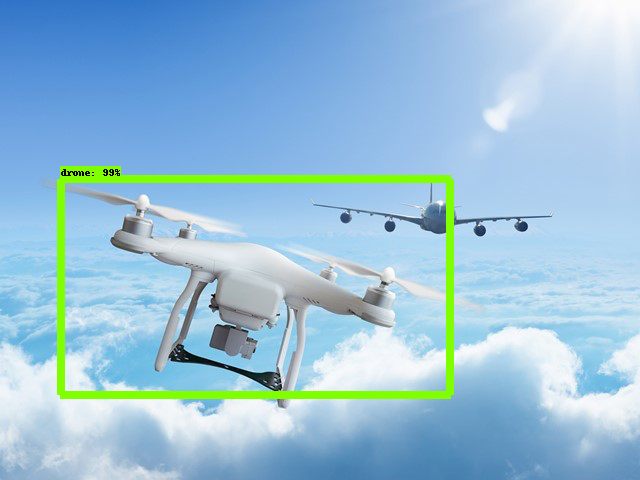

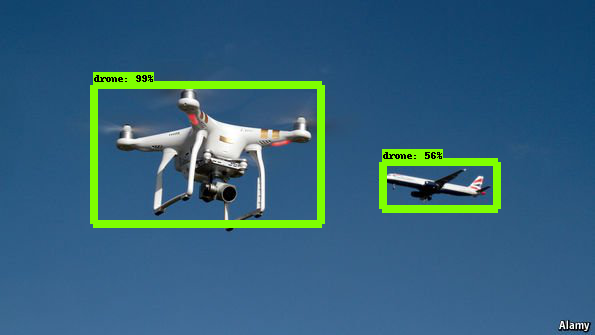

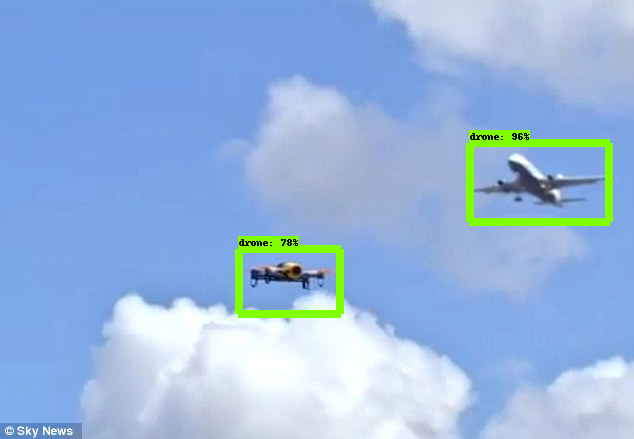

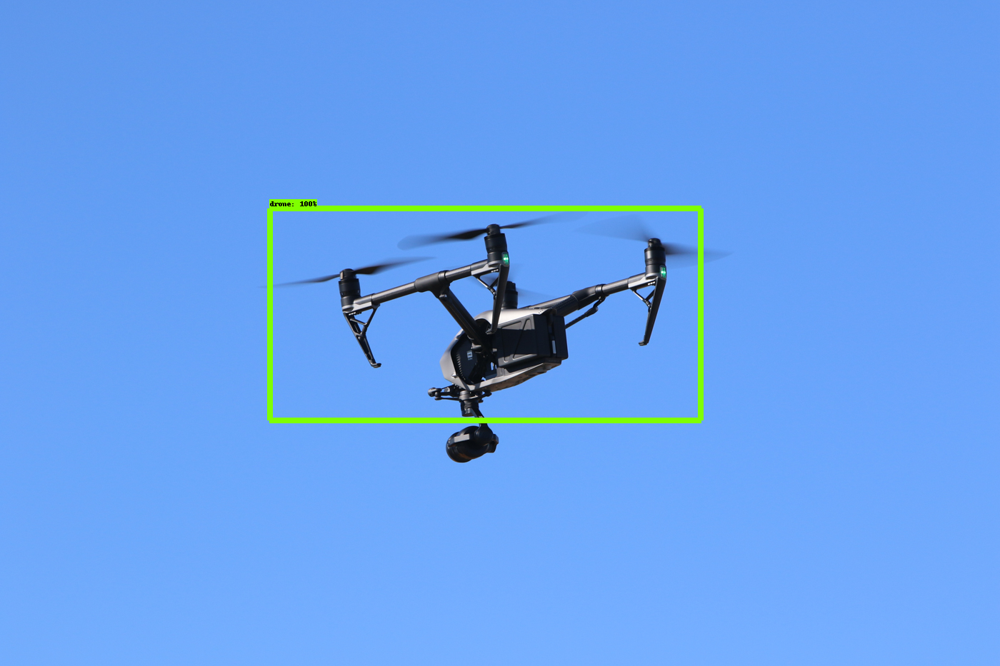

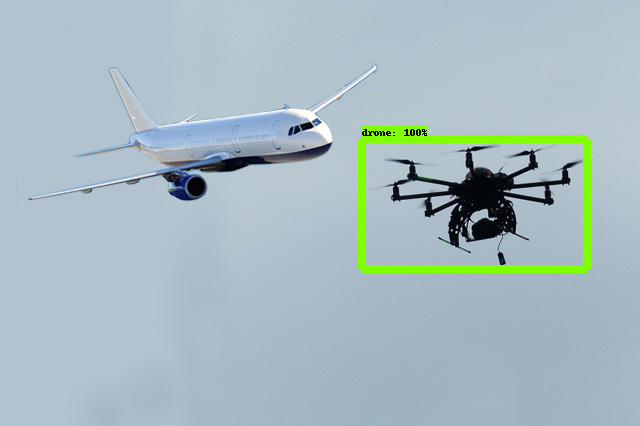

...

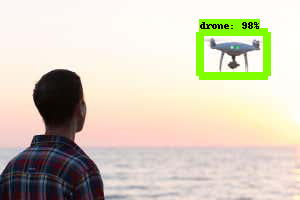

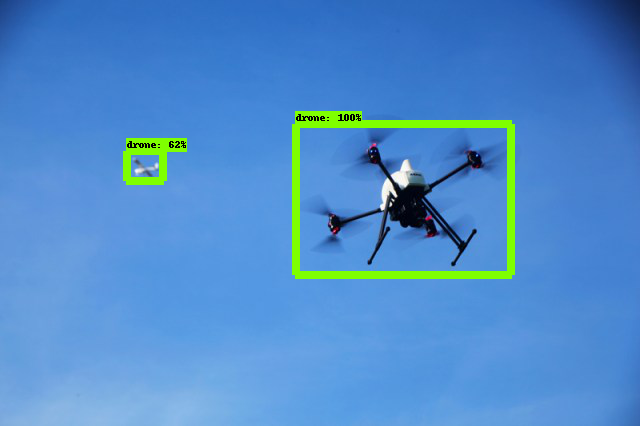

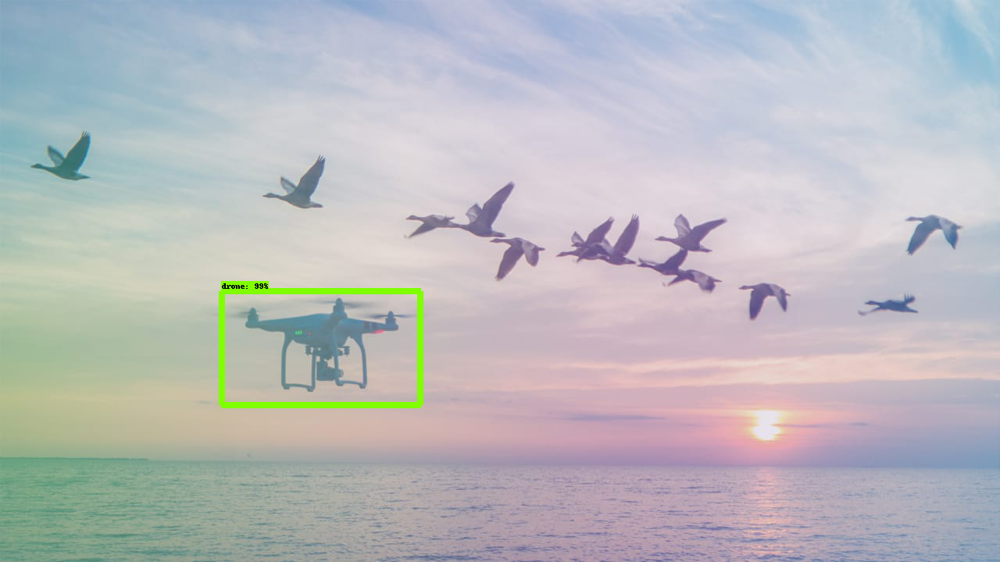

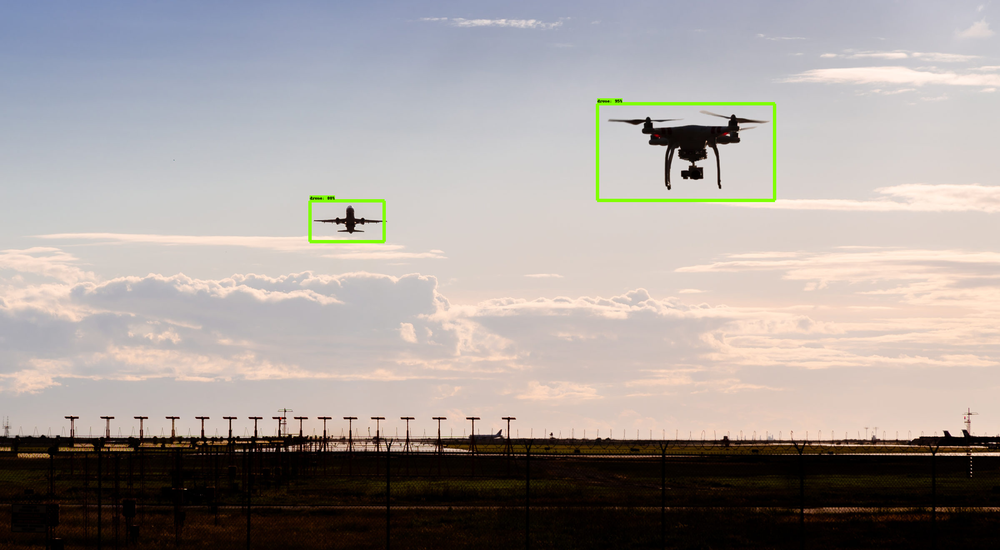

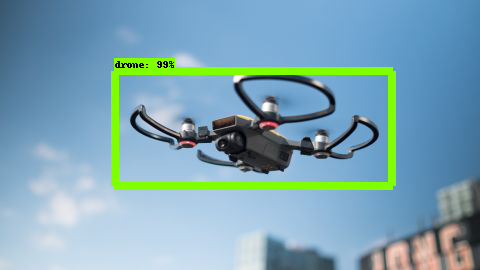

In [40]:
for image_path in TEST_IMAGE_PATHS:
  image_np = load_image_into_numpy_array(image_path)
  output_dict = run_inference_for_single_image(model_efficientdet, image_np)
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      min_score_thresh=0.5,
      line_thickness=8)
  display(Image.fromarray(image_np))

## 10 References

1. https://github.com/tensorflow/models/blob/master/research/object_detection/colab_tutorials/object_detection_tutorial.ipynb
2. https://neptune.ai/blog/how-to-train-your-own-object-detector-using-tensorflow-object-detection-api
3. https://neptune.ai/blog/tensorflow-object-detection-api-best-practices-to-training-evaluation-deployment

## 11 Possibilities of Improvements

1. Data Standardization (Normalize_image)
2. Improving Anchor Box Configuration - Reducing the smallest anchor box size
3. Change aspect_ratio_resizer to fixed_shape_resizer - images quite extensively padded during resizing (contain meaningles information, fixed_shape_resizer reshapes the image to a rectangle with a given size defined by height and width parameters
4. Expand dataset with drone pictures seen from distance
5. More Augmentation Options - random_pixel_value_scale , random_jpeg_quality, random_image_scale 
6. Reduce the convolution stride size
7. Increase score_threshold - parameter that defines a minimum confidence score for classification, which should be reached so the proposal won’t be filtered out. If 0, then all proposals are accepted
8. Use dropout - dropout implementation forces your model to look for those features that best describe objects you want to detect. It helps improve generalization capabilities
9. Update classification and localization weights (for SSD)
